In [2]:
import numpy as np
import scipy

In [5]:
def genSine(A, f, phi, fs, t):
    """
    Inputs:
        A (float) =  amplitude of the sinusoid
        f (float) = frequency of the sinusoid in Hz
        phi (float) = initial phase of the sinusoid in radians
        fs (float) = sampling frequency of the sinusoid in Hz
        t (float) =  duration of the sinusoid (is second)
    Output:
        The function should return a numpy array
        x (numpy array) = The generated sinusoid
    """
    ## Your code here

    return A * np.cos(2 * np.pi * f * np.arange(fs * t) / fs + phi)

In [6]:
from scipy.fftpack import fft

M = 250
epsilon = 1e-6

x1 = genSine(1, 80, 0, 10000, 1)
x2 = genSine(1, 200, 0, 10000, 1)
x = x1 + x2
X = fft(x[:M])
(abs(X) >= epsilon).nonzero()

(array([  2,   5, 245, 248]),)

In [8]:
# http://stackoverflow.com/questions/16241944/playing-a-sound-in-a-ipython-notebook
import IPython
# song from sound cloud
IPython.display.Audio("etude.mp3")


In [11]:
import IPython
# song from sound cloud
IPython.display.Audio("etude-short.wav")


In [62]:
# https://wiki.python.org/moin/Audio/
# https://wiki.python.org/moin/PythonInMusic

# http://stackoverflow.com/questions/13329617/change-the-volume-of-a-wav-file-in-python
import wave, numpy, struct

def read_wave(fn):
    # Open
    w = wave.open(fn,"rb")
    p = w.getparams()
    f = p[3] # number of frames
    s = w.readframes(f)
    w.close()
    return numpy.fromstring(s, numpy.int16)

arr = read_wave("etude-short.wav")

In [84]:
# Save
def save_wave(arr, fn):
    out_s = struct.pack('h'*len(arr), *arr)
    w = wave.open(fn,"wb")
    w.setparams(p)
    w.writeframes(out_s)
    w.close()

save_wave(narr, "etude-modified.wav")
#xarr = read_wave("etude-modified.wav")

/home/ubuntu/miniconda2/lib/python2.7/site-packages/ipykernel/__main__.py:3: DeprecationWarning: integer argument expected, got float
  app.launch_new_instance()


In [85]:
import IPython
IPython.display.Audio("etude-modified.wav")


In [42]:
arr.size

1778398

In [7]:
numpy.max(arr)

32758

In [8]:
numpy.min(arr)

-32768

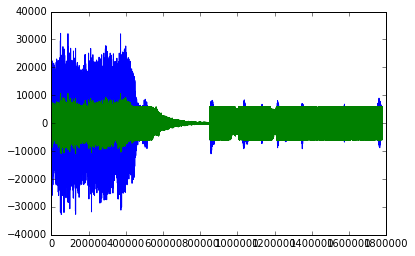

In [83]:
# http://stackoverflow.com/questions/19410042/how-to-make-ipython-notebook-matplotlib-plot-inline
%matplotlib inline

import matplotlib
import matplotlib.pyplot as plt
plt.plot(arr)
plt.plot(narr)
plt.show()


In [86]:
print numpy.max(numpy.abs(arr[:600000]))
print numpy.max(numpy.abs(arr[600000:700000]))
print numpy.max(numpy.abs(arr[900000:]))

print numpy.mean(numpy.abs(arr[:600000]))
print numpy.mean(numpy.abs(arr[600000:700000]))
print numpy.mean(numpy.abs(arr[900000:]))

print numpy.max(numpy.abs(narr[:600000]))
print numpy.max(numpy.abs(narr[600000:700000]))
print numpy.max(numpy.abs(narr[900000:]))

print numpy.mean(numpy.abs(narr[:600000]))
print numpy.mean(numpy.abs(narr[600000:700000]))
print numpy.mean(numpy.abs(narr[900000:]))



32692
878
9155
5109.43103333
175.26877
1224.73155563
10886.0
2634.0
5997.0
2598.114365
525.80631
2293.2471966


In [50]:
arr.dtype


dtype('int16')

In [82]:
narr = numpy.round(arr * numpy.where(abs(arr) > 3000, .333, numpy.where(abs(arr) < 2000, 3, 1)))

In [76]:
numpy.max(narr)

9995.0